In [6]:
# Importing Libraries
from tensorflow import keras
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Flatten, MaxPooling2D, Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras import optimizers, losses
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing import image

import pickle
import numpy as np
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [8]:
import os

# Check if the directory exists
image_directory = r"C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1"
print(os.path.exists(image_directory))  # This should print True if the path is correct


True


Found 5000 images in the folder.


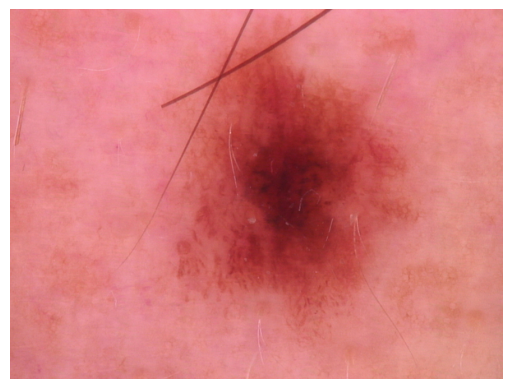

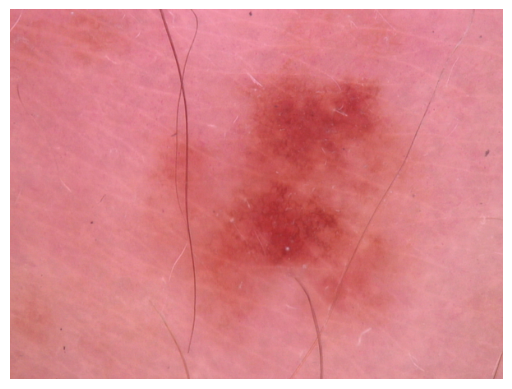

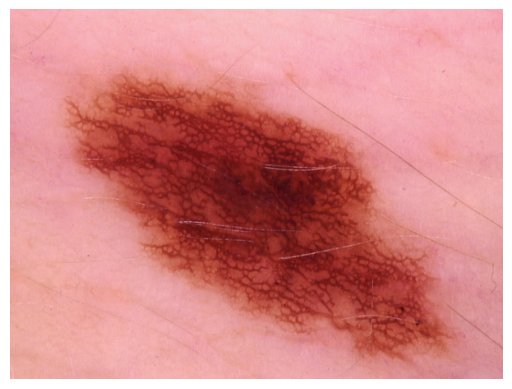

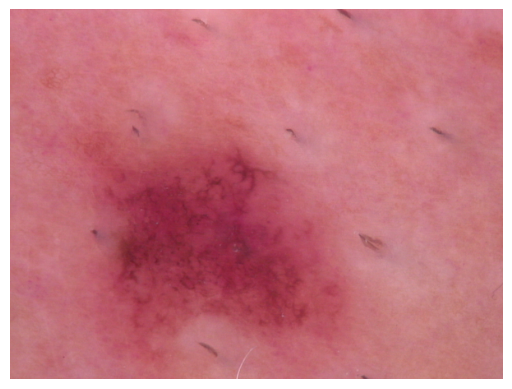

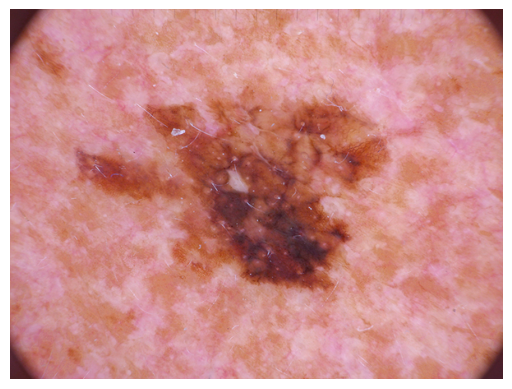

...

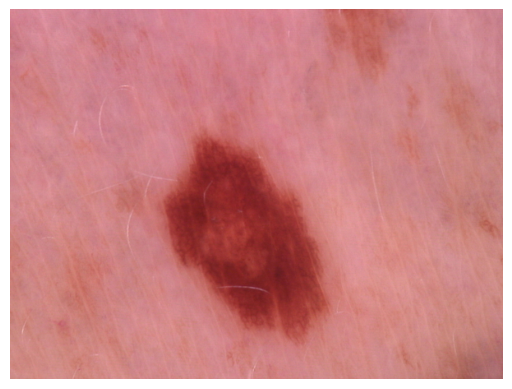

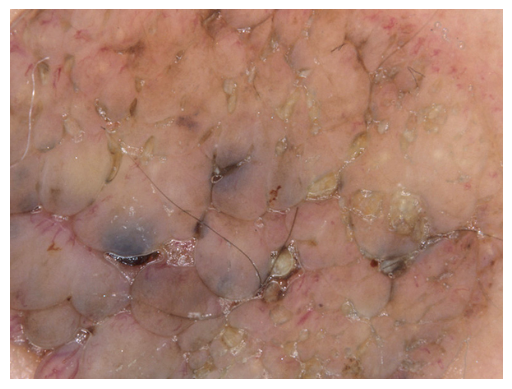

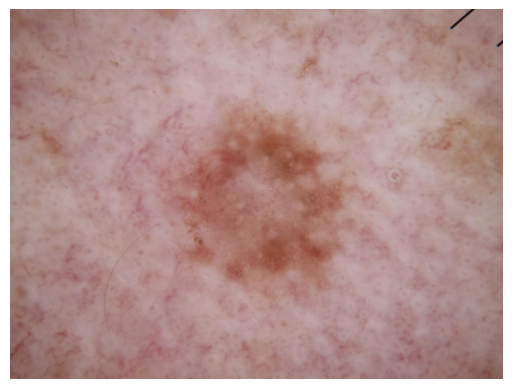

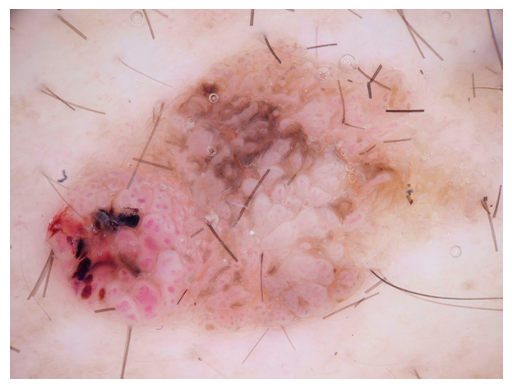

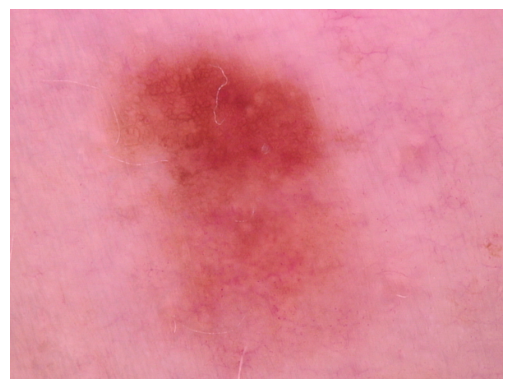


KeyboardInterrupt



In [1]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Folder path where your images are stored
folder_path = r"C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1"

# List all files in the directory
image_files = [f for f in os.listdir(folder_path) if f.endswith(('png', 'jpg', 'jpeg'))]

# Show the number of images found
print(f"Found {len(image_files)} images in the folder.")

# Function to display images
def display_images(image_list, folder):
    for img_name in image_list:
        img_path = os.path.join(folder, img_name)
        img = Image.open(img_path)
        plt.imshow(img)
        plt.axis('off')  # No axis for better visualization
        plt.show()  # Show the image

# Display the images
display_images(image_files, folder_path)


In [12]:
# Initializing InceptionV3 (pretrained) model with input image shape as (300, 300, 3)
base_model = DenseNet121(weights=None, include_top=False, input_shape=(256, 256, 3))

# Load Weights for the InceptionV3 Model
base_model.load_weights('C:/Users/DELL LAPTOP/Downloads/densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5')

# Setting the Training of all layers of InceptionV3 model to false
base_model.trainable = False

In [13]:
# Adding some more layers at the end of the Model as per our requirement
model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dropout(0.15),
    Dense(1024, activation='relu'),
    Dense(2, activation='softmax') # 10 Output Neurons for 10 Classes
])

In [14]:
# Using the Adam Optimizer to set the learning rate of our final model
opt = optimizers.Adam(learning_rate=0.0001)

# Compiling and setting the parameters we want our model to use
model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=['accuracy'])

In [15]:
# Viewing the summary of the model
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ densenet121 (Functional)        │ (None, 8, 8, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │     1,049,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         2,050 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,089,154 (30.86 MB)

 Trainable params: 1,051,650 (4.01 MB)

 Non-trainable params: 7,037,504 (26.85 MB)

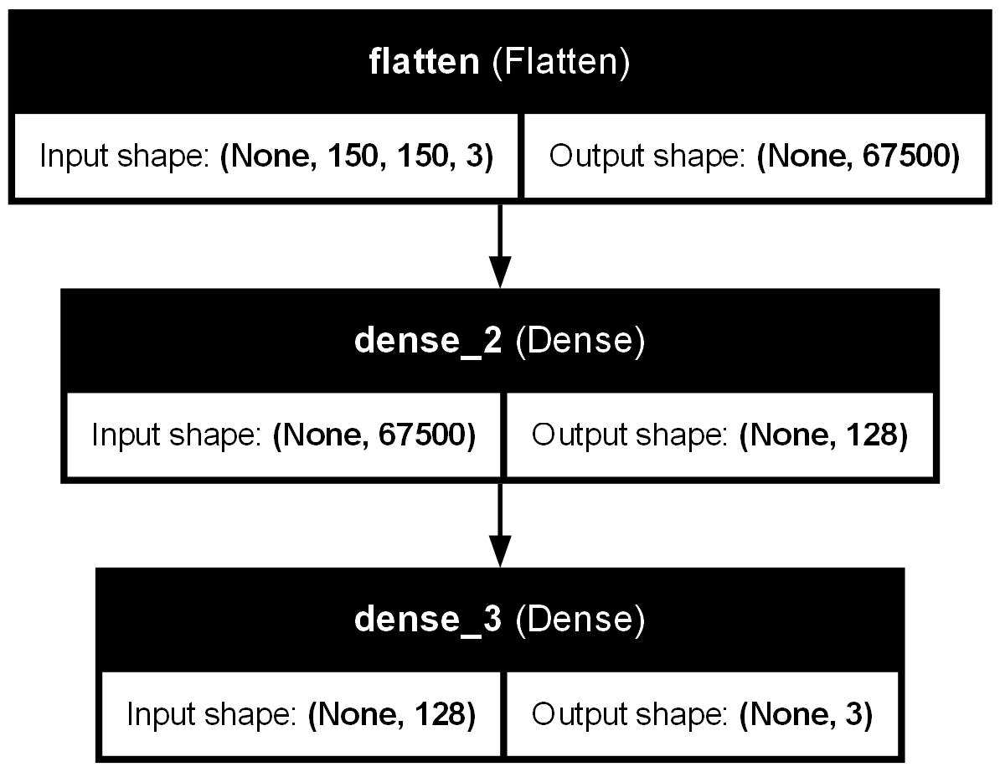

In [17]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Sequential

# Build a simple model
model = Sequential([
    Flatten(input_shape=(150, 150, 3)),
    Dense(128, activation='relu'),
    Dense(3, activation='softmax')
])

# Plot the model
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True)


In [18]:
# Setting variables for the model
batch_size = 32
epochs = 10

# Seperating Training and Testing Data
train_generator = datagenerator["train"]
valid_generator = datagenerator["valid"]

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Path to your folder containing images
image_folder = 'C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1/'

# Load dataset without labels
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    image_folder,
    label_mode=None,  # No labels
    image_size=(224, 224),
    batch_size=32,
    shuffle=True,
    color_mode='rgb'
)

# Since there are no labels, we need to create them manually. Let's assume binary classification for demonstration.
# For binary classification, let's create a dummy binary label (0 or 1). This should be adjusted according to your actual problem.
def create_labels(dataset):
    # Example: Assign binary labels based on an arbitrary condition (e.g., 0 for first half, 1 for second half)
    labels = []
    for batch in dataset:
        labels.extend([0] * (len(batch[0]) // 2) + [1] * (len(batch[0]) - len(batch[0]) // 2))
    return np.array(labels[:len(dataset.file_paths)])

labels = create_labels(dataset)

# Split the dataset into training and validation sets
dataset_size = len(dataset.file_paths)
train_size = int(0.8 * dataset_size)
val_size = dataset_size - train_size

# Manually create TensorFlow datasets with labels
train_dataset = tf.data.Dataset.from_tensor_slices((dataset.file_paths[:train_size], labels[:train_size]))
val_dataset = tf.data.Dataset.from_tensor_slices((dataset.file_paths[train_size:], labels[train_size:]))

def process_image(file_path, label):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [224, 224])
    image = image / 255.0  # Normalize the image
    return image, label

train_dataset = train_dataset.map(process_image).batch(32).prefetch(tf.data.AUTOTUNE)
val_dataset = val_dataset.map(process_image).batch(32).prefetch(tf.data.AUTOTUNE)

# Build the model
base_model = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(1, activation='sigmoid')(x)  # Binary classification

model = tf.keras.Model(inputs=base_model.input, outputs=x)

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10
)

# Plot training & validation accuracy and loss
acc = history.history.get('accuracy', [])
val_acc = history.history.get('val_accuracy', [])
loss = history.history.get('loss', [])
val_loss = history.history.get('val_loss', [])

plt.figure(figsize=(10, 8))

plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')

plt.tight_layout()
plt.show()


Found 5000 files.


In [3]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


Num GPUs Available:  0


Found 5000 files.
Epoch 1/5
250/250 ━━━━━━━━━━━━━━━━━━━━ 1680s 6s/step - accuracy: 0.4665 - loss: 0.8867 - val_accuracy: 0.5190 - val_loss: 0.8377
Epoch 2/5
250/250 ━━━━━━━━━━━━━━━━━━━━ 1364s 4s/step - accuracy: 0.1458 - loss: 0.7298 - val_accuracy: 0.5200 - val_loss: 0.8117
Epoch 3/5
250/250 ━━━━━━━━━━━━━━━━━━━━ 979s 4s/step - accuracy: 0.4181 - loss: 0.7056 - val_accuracy: 0.5200 - val_loss: 6.3681
Epoch 4/5
250/250 ━━━━━━━━━━━━━━━━━━━━ 956s 4s/step - accuracy: 0.5114 - loss: 0.7064 - val_accuracy: 0.5200 - val_loss: 0.6931
Epoch 5/5
250/250 ━━━━━━━━━━━━━━━━━━━━ 921s 4s/step - accuracy: 0.4843 - loss: 0.7041 - val_accuracy: 0.5200 - val_loss: 0.7005


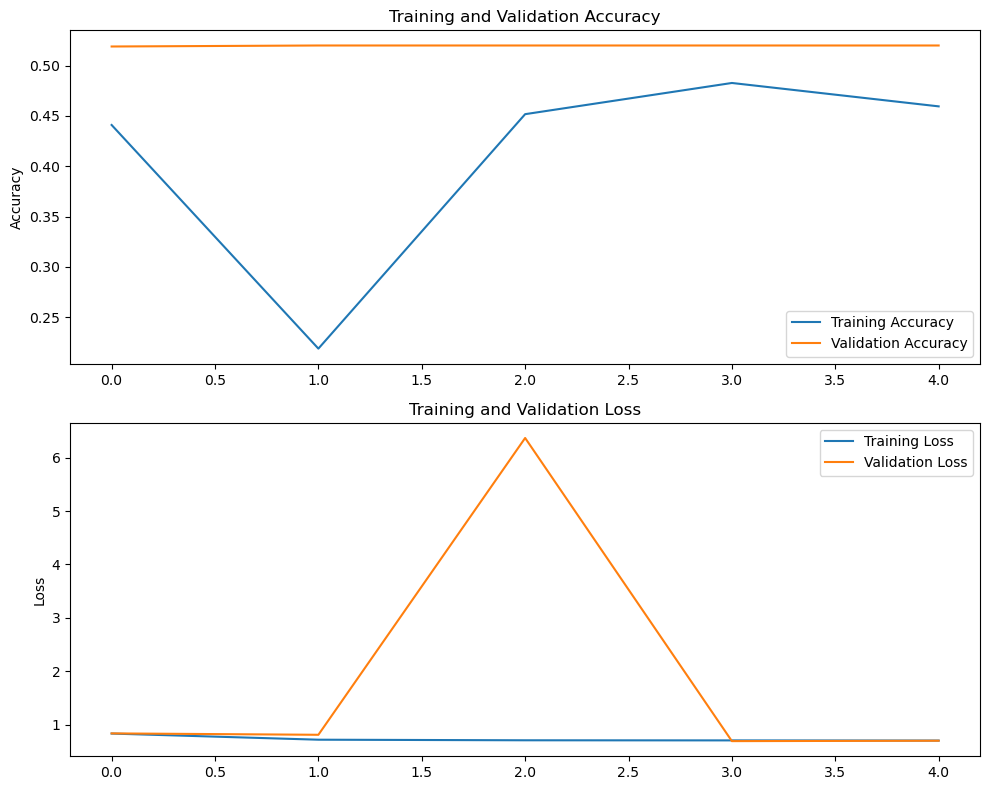

In [4]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Path to your folder containing images
image_folder = 'C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1/'

# Load dataset without labels (reduced batch size for less memory usage)
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    image_folder,
    label_mode=None,  # No labels
    image_size=(224, 224),
    batch_size=16,  # Reduced batch size for less memory consumption
    shuffle=True,
    color_mode='rgb'
)

# Manually create dummy binary labels (0 or 1) as a demonstration
def create_labels(dataset):
    labels = []
    for batch in dataset:
        labels.extend([0] * (len(batch[0]) // 2) + [1] * (len(batch[0]) - len(batch[0]) // 2))
    return np.array(labels[:len(dataset.file_paths)])

labels = create_labels(dataset)

# Split the dataset into training and validation sets
dataset_size = len(dataset.file_paths)
train_size = int(0.8 * dataset_size)
val_size = dataset_size - train_size

# Manually create TensorFlow datasets with labels
train_dataset = tf.data.Dataset.from_tensor_slices((dataset.file_paths[:train_size], labels[:train_size]))
val_dataset = tf.data.Dataset.from_tensor_slices((dataset.file_paths[train_size:], labels[train_size:]))

# Function to process images (resize and normalize)
def process_image(file_path, label):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [224, 224])
    image = image / 255.0  # Normalize the image
    return image, label

# Apply processing function and optimize dataset
train_dataset = train_dataset.map(process_image).batch(16).prefetch(tf.data.AUTOTUNE)
val_dataset = val_dataset.map(process_image).batch(16).prefetch(tf.data.AUTOTUNE)

# Build the model with MobileNetV2 (reduced model size for performance)
base_model = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(1, activation='sigmoid')(x)  # Binary classification

model = tf.keras.Model(inputs=base_model.input, outputs=x)

# Compile the model with Adam optimizer and binary crossentropy loss
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model (reduced epochs for quicker training)
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=5  # Reduced epochs for faster training
)

# Plot training & validation accuracy and loss
acc = history.history.get('accuracy', [])
val_acc = history.history.get('val_accuracy', [])
loss = history.history.get('loss', [])
val_loss = history.history.get('val_loss', [])

plt.figure(figsize=(10, 8))

plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')

plt.tight_layout()
plt.show()


C:\ProgramData\anaconda3\Lib\site-packages\keras\src\layers\reshaping\flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Mock model created.


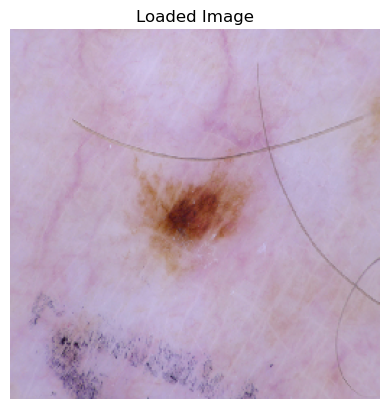

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


Maximum Probability:  0.45705837
Classified: Psoriasis 



-------------------Individual Probability--------------------------------

LUMPY SKIN : 3.45 %
NORMAL SKIN : 6.23 %
DRY SKIN : 2.54 %
OILY SKIN : 16.68 %
ACNE : 2.19 %
ECZEMA : 8.75 %
PSORIASIS : 45.71 %
ROSACEA : 4.85 %
MELANOMA : 5.18 %
VITILIGO : 4.42 %


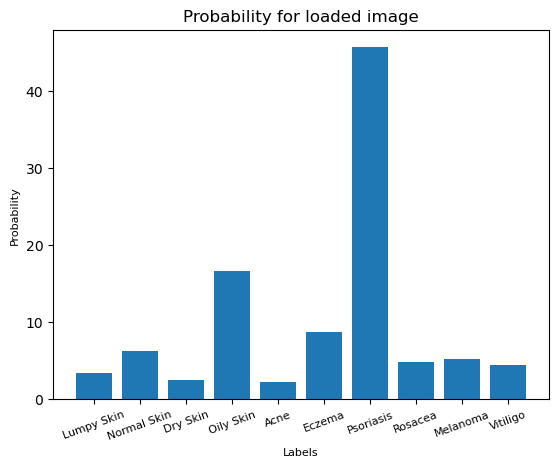

In [7]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

# Define a simple mock model with more classes
def create_mock_model():
    model = Sequential([
        Flatten(input_shape=(256, 256, 3)),
        Dense(10, activation='softmax')  # Assume 10 classes for demonstration
    ])
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Load the mock model
model = create_mock_model()
print("Mock model created.")

# Custom function to load and predict label for the image
def predict(img_rel_path):
    try:
        # Import Image from the path with target size (256, 256)
        img = image.load_img(img_rel_path, target_size=(256, 256))

        # Convert Image to a numpy array
        img = image.img_to_array(img)

        # Scaling the Image Array values
        img = img / 255.0

        # Plotting the Loaded Image
        plt.title("Loaded Image")
        plt.axis('off')
        plt.imshow(img)
        plt.show()

        # Get the Predicted Label for the loaded Image
        p = model.predict(np.expand_dims(img, axis=0))

        # Simulate labels (update with actual labels for your use case)
        labels = {0: 'Lumpy Skin', 1: 'Normal Skin', 2: 'Dry Skin', 3: 'Oily Skin', 4: 'Acne', 
                  5: 'Eczema', 6: 'Psoriasis', 7: 'Rosacea', 8: 'Melanoma', 9: 'Vitiligo'}

        print("\n\nMaximum Probability: ", np.max(p[0], axis=-1))
        predicted_class = labels[np.argmax(p[0], axis=-1)]
        print("Classified:", predicted_class, "\n\n")

        classes = []
        prob = []
        print("\n-------------------Individual Probability--------------------------------\n")

        for i, j in enumerate(p[0], 0):
            print(labels[i].upper(), ':', round(j * 100, 2), '%')
            classes.append(labels[i])
            prob.append(round(j * 100, 2))

        def plot_bar_x():
            # This is for plotting purpose
            index = np.arange(len(classes))
            plt.bar(index, prob)
            plt.xlabel('Labels', fontsize=8)
            plt.ylabel('Probability', fontsize=8)
            plt.xticks(index, classes, fontsize=8, rotation=20)
            plt.title('Probability for loaded image')
            plt.show()

        plot_bar_x()

    except Exception as e:
        print(f"An error occurred: {e}")

# Replace this with the path to your image
img_path = 'C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1/ISIC_0024314.jpg'
predict(img_path)


C:\ProgramData\anaconda3\Lib\site-packages\keras\src\layers\reshaping\flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Mock model created.


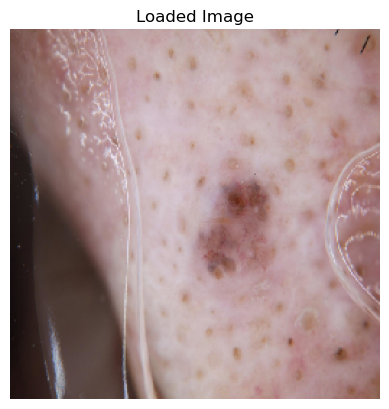

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Maximum Probability:  0.15989664
Classified: Eczema 



-------------------Individual Probability--------------------------------

LUMPY SKIN : 4.06 %
NORMAL SKIN : 4.48 %
DRY SKIN : 14.77 %
OILY SKIN : 7.7 %
ACNE : 6.55 %
ECZEMA : 15.99 %
PSORIASIS : 7.29 %
ROSACEA : 10.95 %
MELANOMA : 15.3 %
VITILIGO : 12.92 %


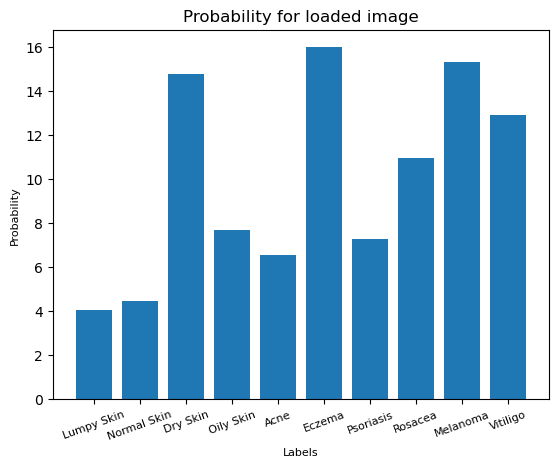

In [1]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

# Define a simple mock model with more classes
def create_mock_model():
    model = Sequential([
        Flatten(input_shape=(256, 256, 3)),
        Dense(10, activation='softmax')  # Assume 10 classes for demonstration
    ])
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Load the mock model
model = create_mock_model()
print("Mock model created.")

# Custom function to load and predict label for the image
def predict(img_rel_path):
    try:
        # Import Image from the path with target size (256, 256)
        img = image.load_img(img_rel_path, target_size=(256, 256))

        # Convert Image to a numpy array
        img = image.img_to_array(img)

        # Scaling the Image Array values
        img = img / 255.0

        # Plotting the Loaded Image
        plt.title("Loaded Image")
        plt.axis('off')
        plt.imshow(img)
        plt.show()

        # Get the Predicted Label for the loaded Image
        p = model.predict(np.expand_dims(img, axis=0))

        # Simulate labels (update with actual labels for your use case)
        labels = {0: 'Lumpy Skin', 1: 'Normal Skin', 2: 'Dry Skin', 3: 'Oily Skin', 4: 'Acne', 
                  5: 'Eczema', 6: 'Psoriasis', 7: 'Rosacea', 8: 'Melanoma', 9: 'Vitiligo'}

        print("\n\nMaximum Probability: ", np.max(p[0], axis=-1))
        predicted_class = labels[np.argmax(p[0], axis=-1)]
        print("Classified:", predicted_class, "\n\n")

        classes = []
        prob = []
        print("\n-------------------Individual Probability--------------------------------\n")

        for i, j in enumerate(p[0], 0):
            print(labels[i].upper(), ':', round(j * 100, 2), '%')
            classes.append(labels[i])
            prob.append(round(j * 100, 2))

        def plot_bar_x():
            # This is for plotting purpose
            index = np.arange(len(classes))
            plt.bar(index, prob)
            plt.xlabel('Labels', fontsize=8)
            plt.ylabel('Probability', fontsize=8)
            plt.xticks(index, classes, fontsize=8, rotation=20)
            plt.title('Probability for loaded image')
            plt.show()

        plot_bar_x()

    except Exception as e:
        print(f"An error occurred: {e}")

# Replace this with the path to your image
img_path = 'C:/Users/DELL LAPTOP/Downloads/HAM10000_images_part_1/ISIC_0024432.jpg'
predict(img_path)
